In [1]:
import joblib
import dotenv
import pathlib

project_folder = pathlib.Path(dotenv.find_dotenv()).parent.absolute()
data_folder = project_folder.joinpath("notebooks", "data")

In [2]:
X_fpath = data_folder.joinpath("features.pkl")
X = joblib.load(X_fpath)

In [3]:
Y_fpath = data_folder.joinpath("target.pkl")
Y = joblib.load(Y_fpath)

In [4]:
X.head()

,18,19,25,30,41,43,55,87,100,124,...,127833,134864,154807,162514,200959,203068,255738,338442,338557,548596
index,,,,,,,,,,,,,,,,,,,,,
GTEX.1117F.0226.SM.5GZZ7,0.317665,0.458580,0.475477,0.359000,0.189063,0.223048,0.153920,0.469224,0.317083,0.223048,...,0.124269,1.627636e-02,0.375524,0.248760,1.688435e-16,0.477527,0.133313,0.147872,0.143895,1.603941e-01
GTEX.111CU.1826.SM.5GZYN,0.310635,0.403279,0.450367,0.377898,0.202662,0.198975,0.210150,0.457888,0.357860,0.213907,...,0.132201,1.688435e-16,0.446102,0.220727,1.688435e-16,0.462783,0.045873,0.338529,0.281507,1.688435e-16
GTEX.111FC.0226.SM.5N9B8,0.273036,0.400844,0.439983,0.355321,0.243211,0.227091,0.118643,0.471758,0.343834,0.162724,...,0.167754,1.688435e-16,0.375780,0.241828,1.688435e-16,0.482021,0.079564,0.179598,0.160711,2.100090e-02
GTEX.111VG.2326.SM.5N9BK,0.304227,0.394599,0.441530,0.382837,0.224171,0.228116,0.161616,0.477043,0.338001,0.171134,...,0.135484,1.688435e-16,0.402339,0.287238,1.688435e-16,0.490011,0.169080,0.268850,0.250149,4.095755e-02
GTEX.111YS.2426.SM.5GZZQ,0.317121,0.469217,0.443515,0.370553,0.164537,0.166544,0.164537,0.457146,0.312981,0.188892,...,0.180401,1.688435e-16,0.425451,0.204232,1.688435e-16,0.463205,0.064560,0.250160,0.242333,1.743191e-02


In [5]:
Y.head()

index,P.hsa04022.45,P.hsa04024.109,P.hsa04024.110,P.hsa04024.111,P.hsa04024.44.67,P.hsa04150.31,P.hsa04150.56,P.hsa04150.33,P.hsa04151.34,P.hsa04151.24,...,P.hsa04915.21,P.hsa04915.30,P.hsa04916.15,P.hsa04918.10,P.hsa04922.51,P.hsa04922.50,P.hsa04922.59,P.hsa04925.33,P.hsa04925.34,P.hsa04962.10
index,,,,,,,,,,,,,,,,,,,,,
GTEX.1117F.0226.SM.5GZZ7,0.087357,3.730543e-07,0.000003,0.000003,0.000229,7.401523e-08,1.428105e-08,1.640885e-08,0.002674,0.003113,...,2.545116e-08,0.000405,0.000677,0.000213,0.035375,0.042659,0.046566,1.839283e-02,0.115289,0.000000
GTEX.111CU.1826.SM.5GZYN,0.091121,1.983882e-07,0.000002,0.000002,0.000111,7.296563e-08,2.021472e-08,2.286448e-08,0.003043,0.003378,...,1.840547e-08,0.000386,0.000639,0.000000,0.035428,0.045868,0.042899,1.653444e-02,0.076173,0.000302
GTEX.111FC.0226.SM.5N9B8,0.115059,8.808699e-07,0.000002,0.000003,0.000196,7.947040e-08,1.461446e-08,1.695928e-08,0.002422,0.002936,...,1.845962e-08,0.000406,0.000795,0.000233,0.032531,0.036581,0.045283,1.100567e-16,0.023564,0.000010
GTEX.111VG.2326.SM.5N9BK,0.093319,8.493193e-07,0.000004,0.000003,0.000273,7.372298e-08,1.958142e-08,2.330365e-08,0.002727,0.003234,...,3.504110e-08,0.000265,0.000699,0.000167,0.030134,0.039915,0.038884,1.799916e-02,0.094514,0.000175
GTEX.111YS.2426.SM.5GZZQ,0.087933,7.196401e-07,0.000003,0.000004,0.000251,7.276775e-08,1.960031e-08,2.205129e-08,0.002775,0.003096,...,1.759070e-08,0.000000,0.000662,0.000489,0.026815,0.037412,0.035380,9.605669e-17,0.075112,0.000076


<AxesSubplot:xlabel='index'>

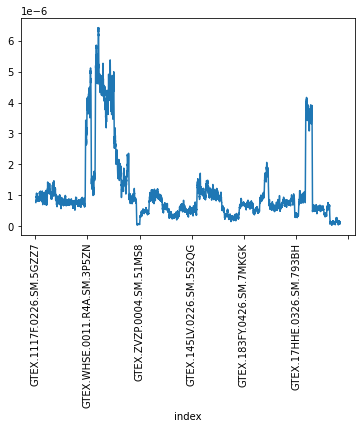

In [6]:
Y.iloc[:, 1].rolling(20).mean().plot(rot=90)

In [7]:
from sklearn.model_selection import cross_validate, ShuffleSplit, train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import MultiTaskLasso, RidgeCV
from sklearn.cross_decomposition import PLSRegression, PLSCanonical
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process import kernels
import numpy as np

In [8]:
from sklearn.feature_selection import SelectFromModel
from sklearn.pipeline import make_pipeline

In [9]:
model = make_pipeline(SelectFromModel(MultiTaskLasso(alpha=1e-4)), RidgeCV())

In [10]:
num_pathways = Y.columns.str.split(".").str[1].nunique()

In [101]:
cv = ShuffleSplit(n_splits=1, random_state=42, train_size=0.3).split(X, Y)
r = cross_validate(model, X, Y, n_jobs=-1, cv=cv)
r

{'fit_time': array([169.85309815]),
 'score_time': array([0.09443426]),
 'test_score': array([0.82840177])}

In [11]:
X_train, X_test, y_train, y_test = train_test_split(
    X,
    (Y - Y.mean()) / Y.std(),
    test_size=0.3,
    random_state=42)

In [79]:
model = GaussianProcessRegressor(kernel=kernels.DotProduct())
model = RidgeCV(normalize=True)

In [103]:
model.fit(X_train, y_train)
model.score(X_test, y_test)

0.8322841238914789

In [13]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.style.use("ggplot")#

#sns.heatmap(model.coef_)

In [14]:
import shap

In [83]:
explainer = shap.LinearExplainer(model, data=X_train)

In [84]:
s = explainer.shap_values(X_test)
s = np.array(s)

In [85]:
s_abs = np.abs(s)

In [86]:
s.shape, s_abs.shape

((80, 3507, 683), (80, 3507, 683))

In [87]:
s = np.moveaxis(s, source=0, destination=1)

In [88]:
import pandas as pd
r = compute_shap_relevance(s, X_test, y_test)

In [89]:
f = compute_shap_fs(r, by_circuit=True)

In [90]:
f.any().sum()

565

In [94]:
from sklearn.preprocessing import MinMaxScaler

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


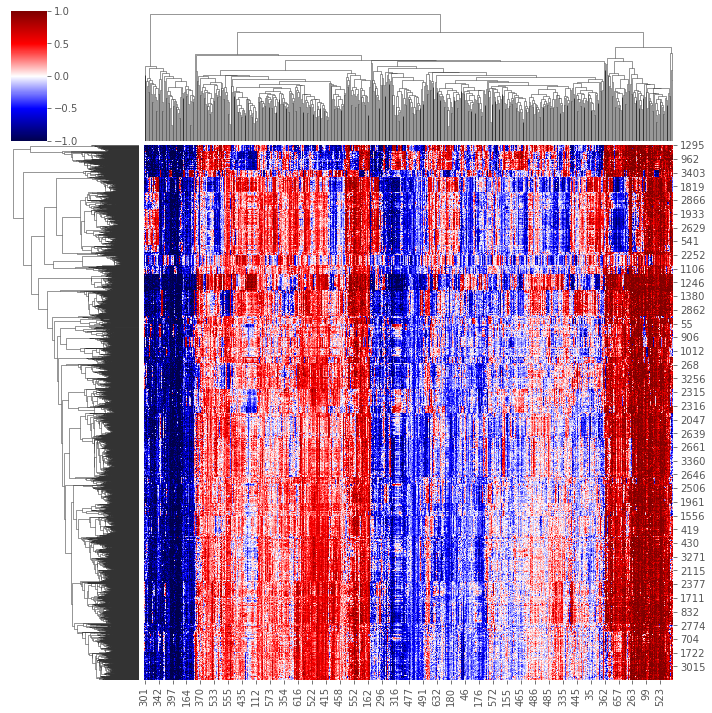

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


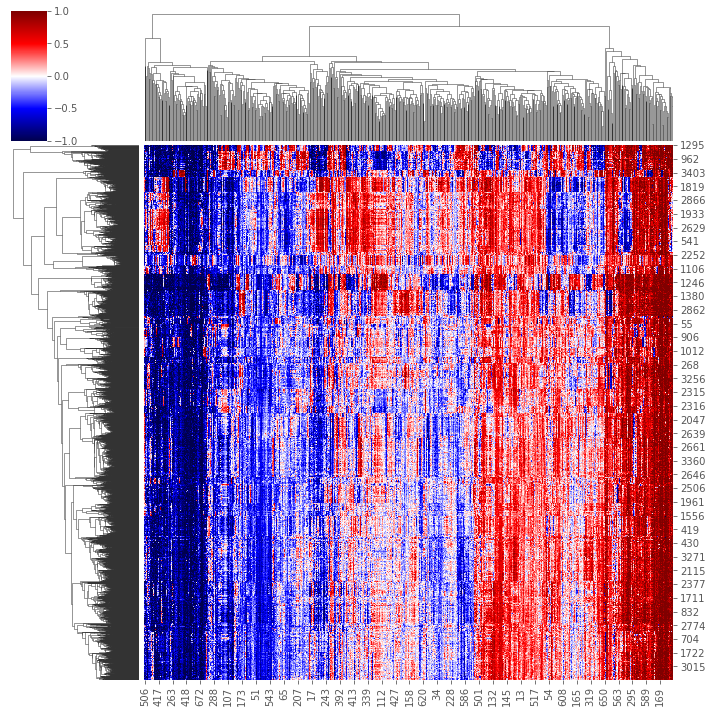

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


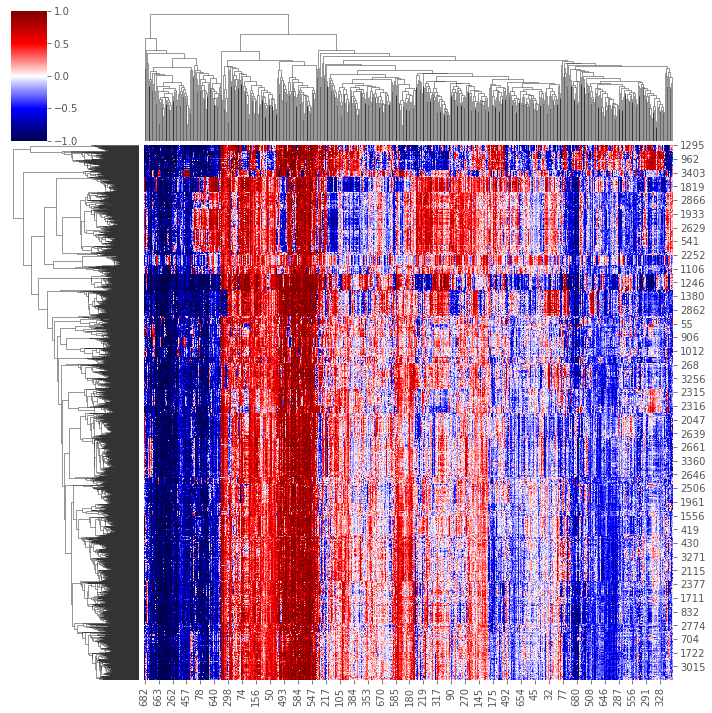

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


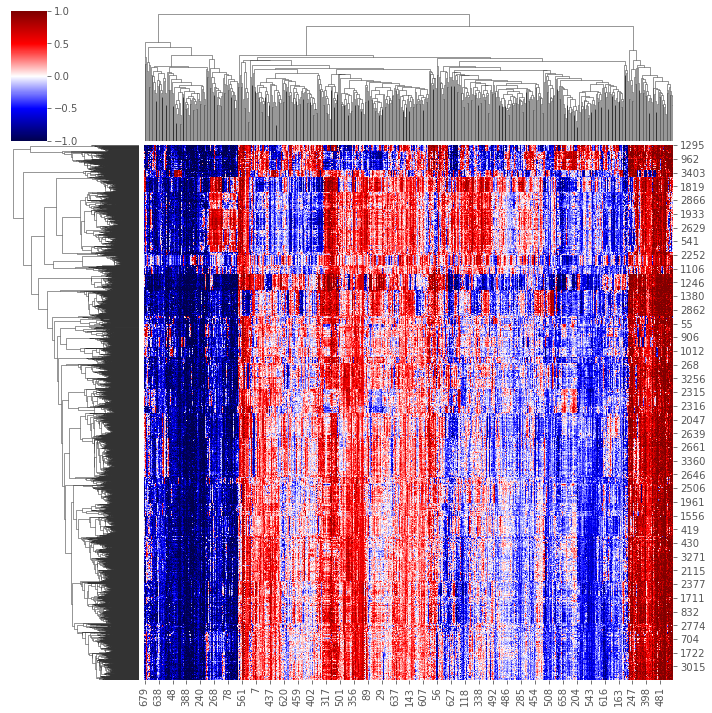

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


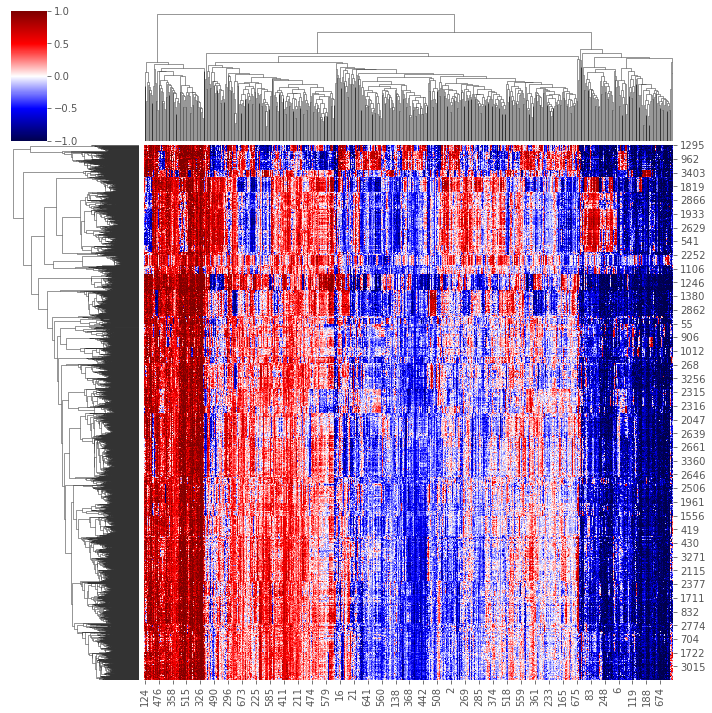

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


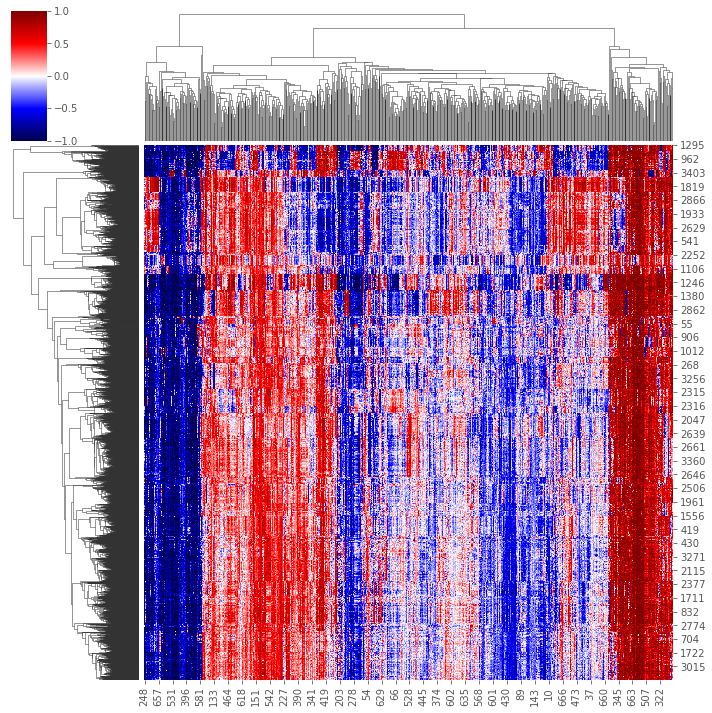

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


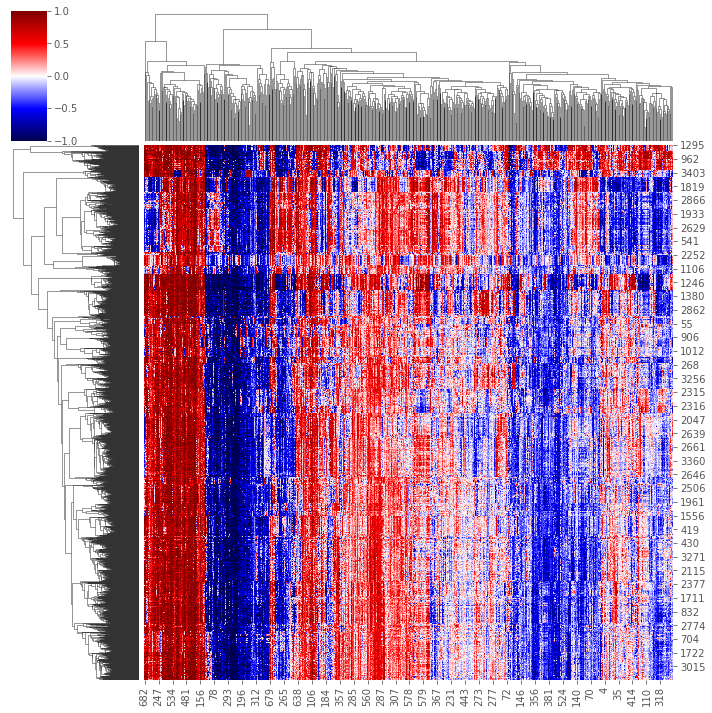

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


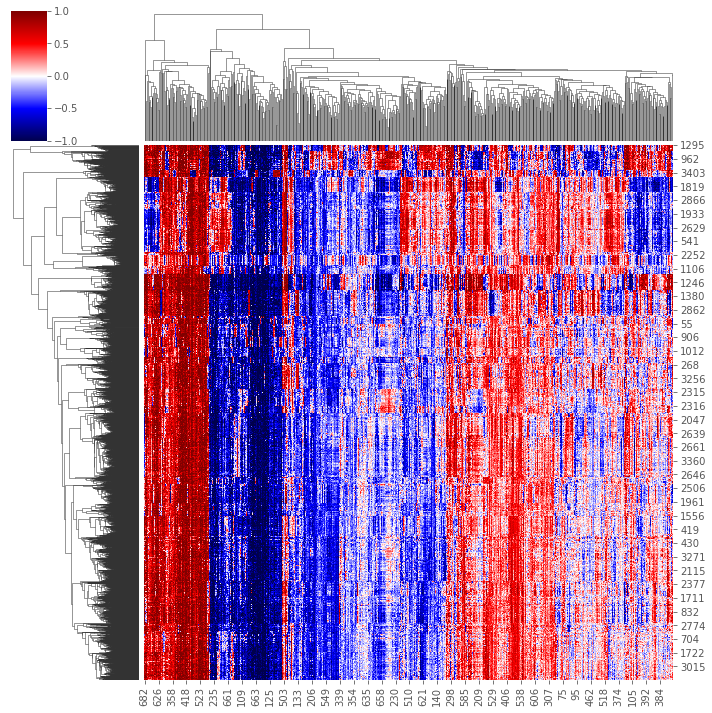

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


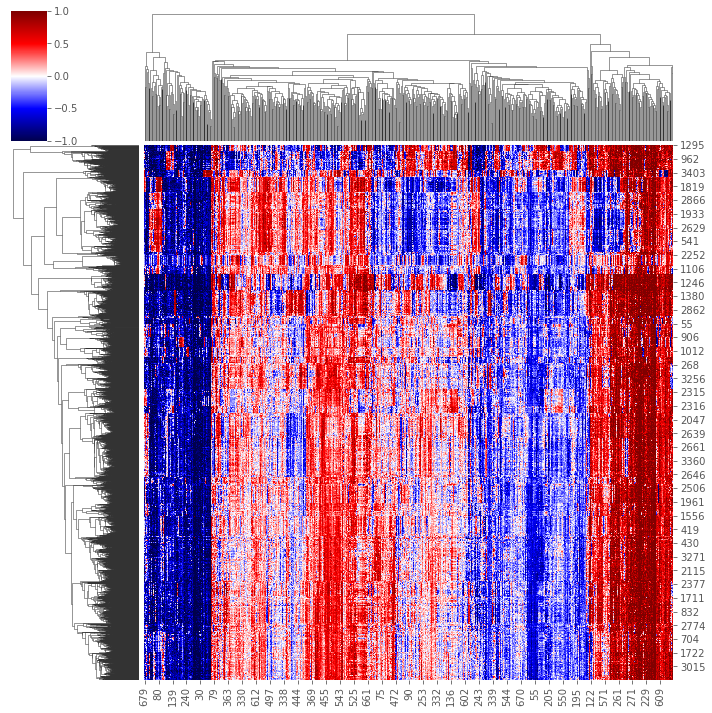

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


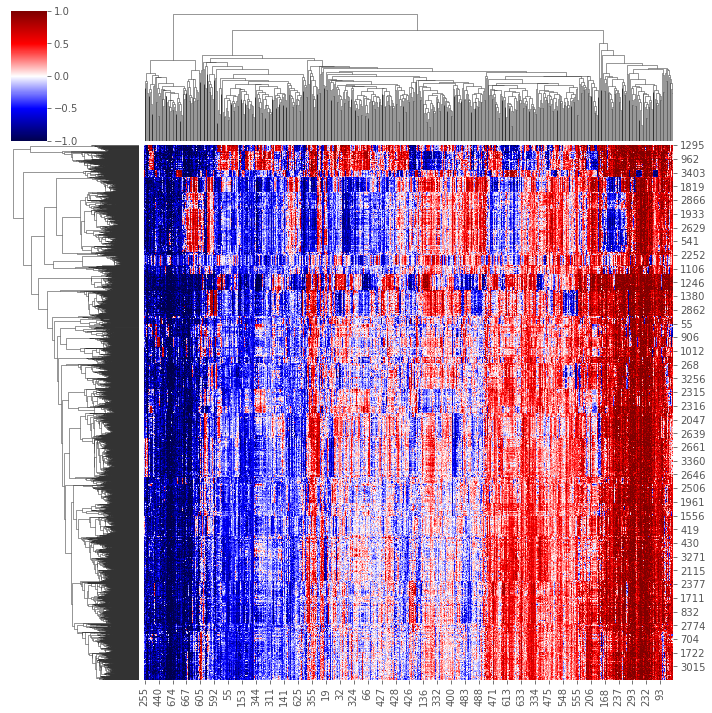

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


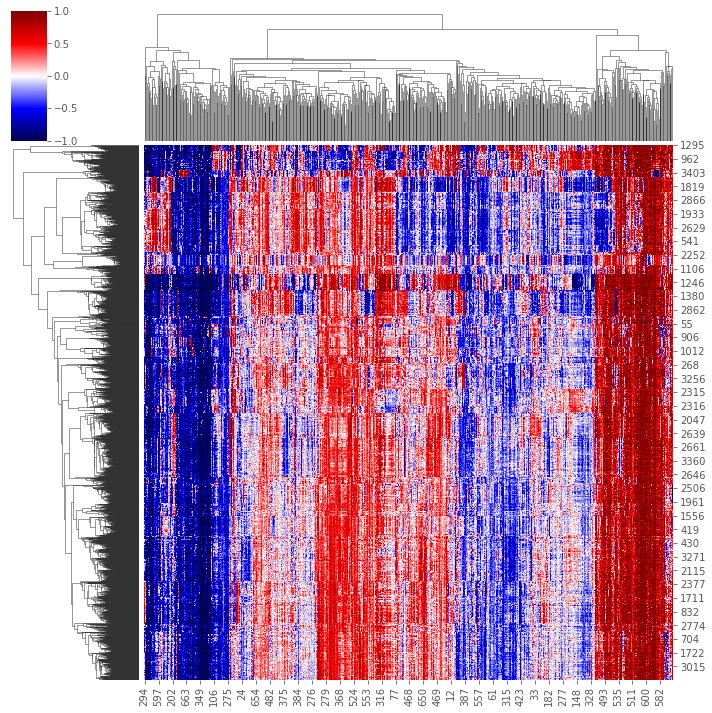

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


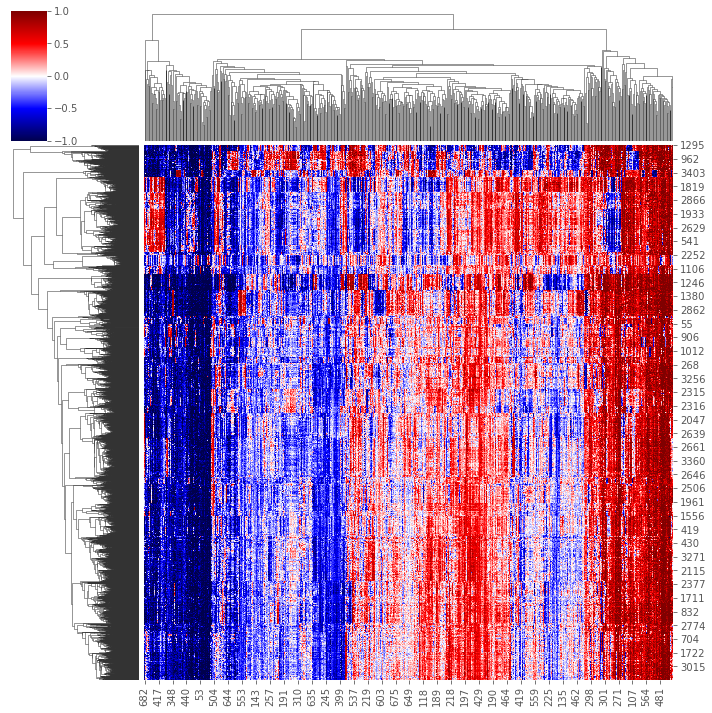

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


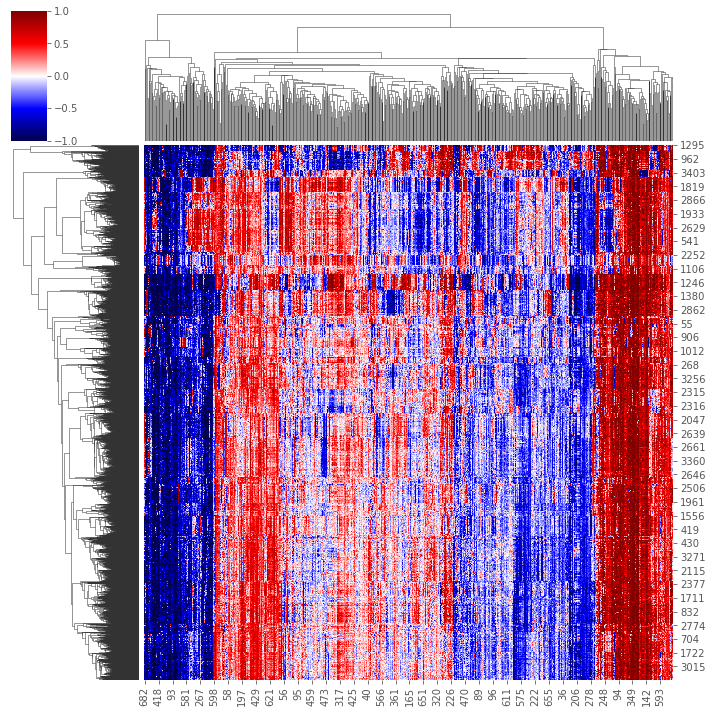

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


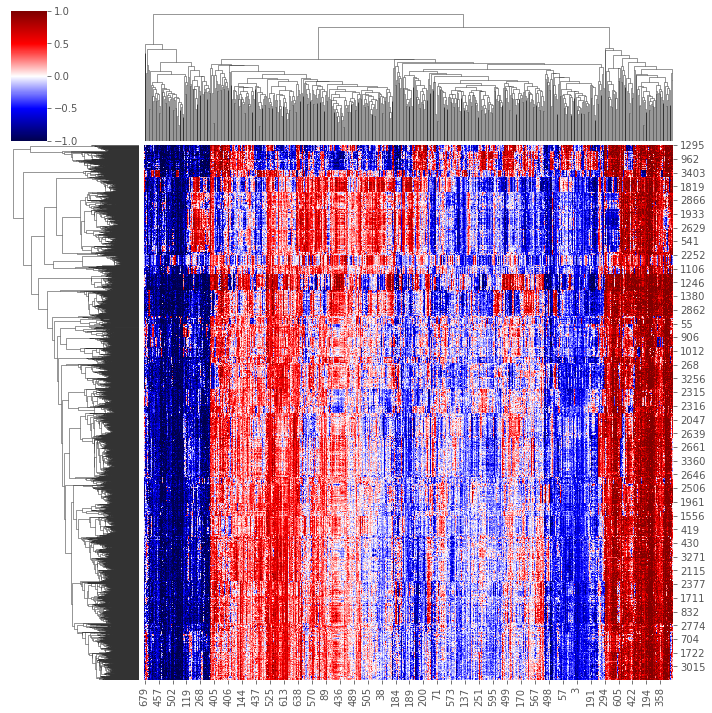

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


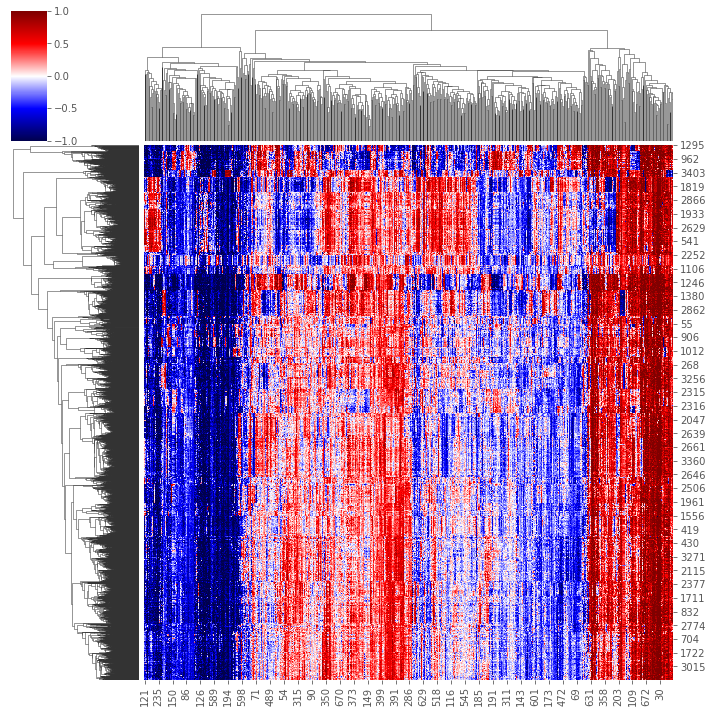

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


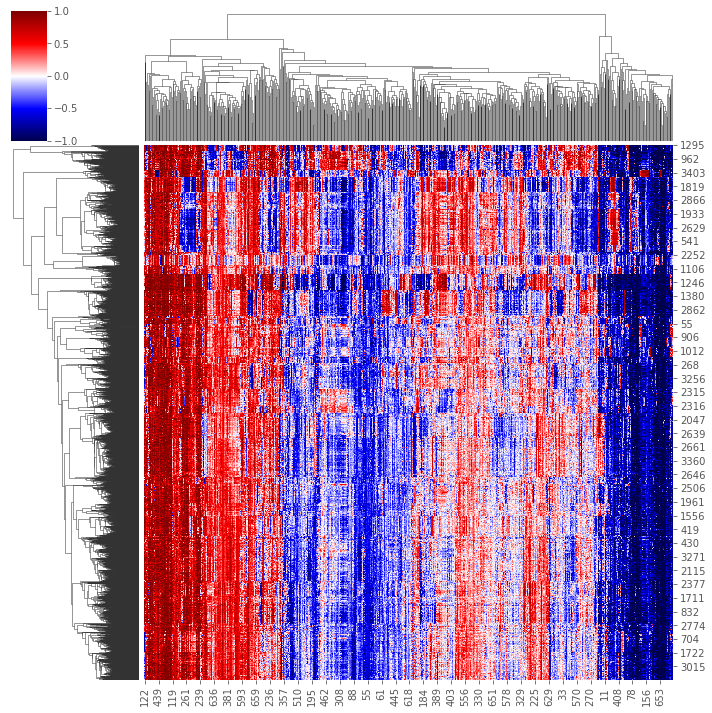

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


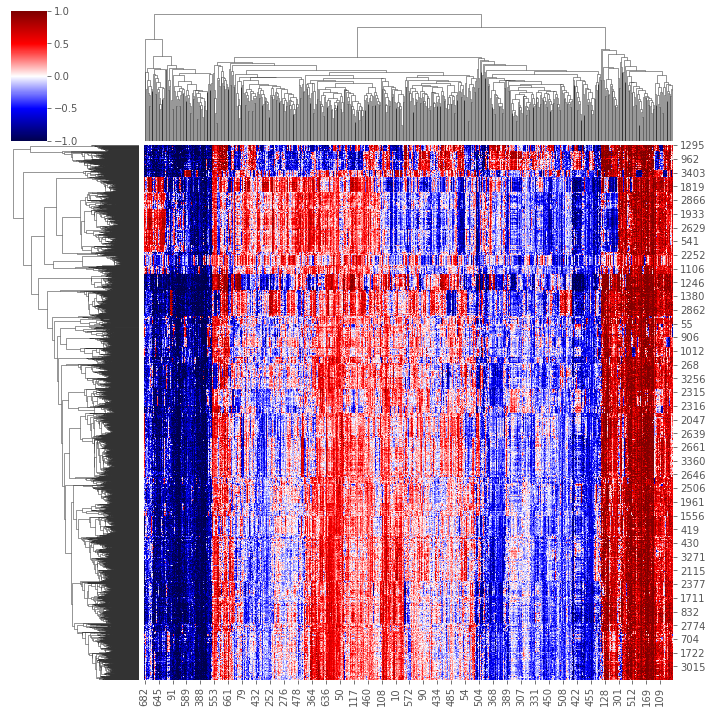

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


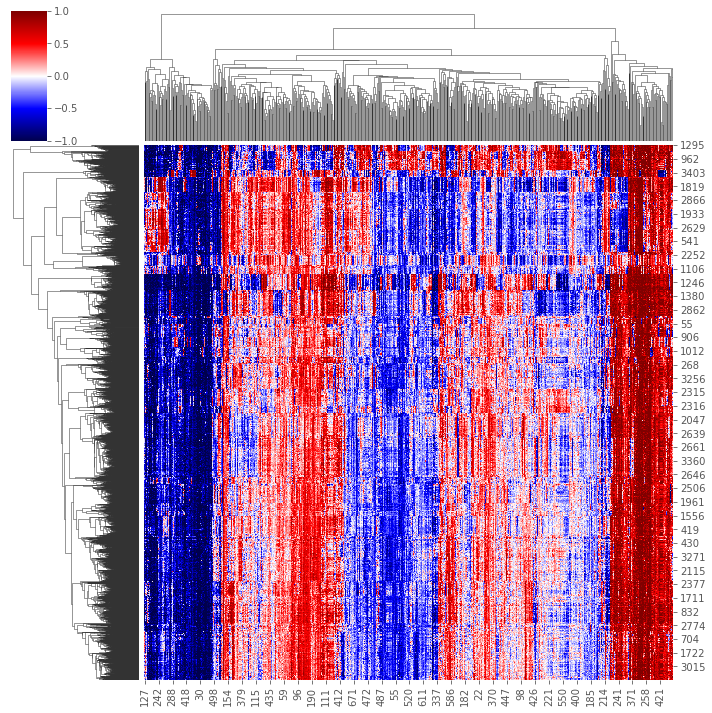

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


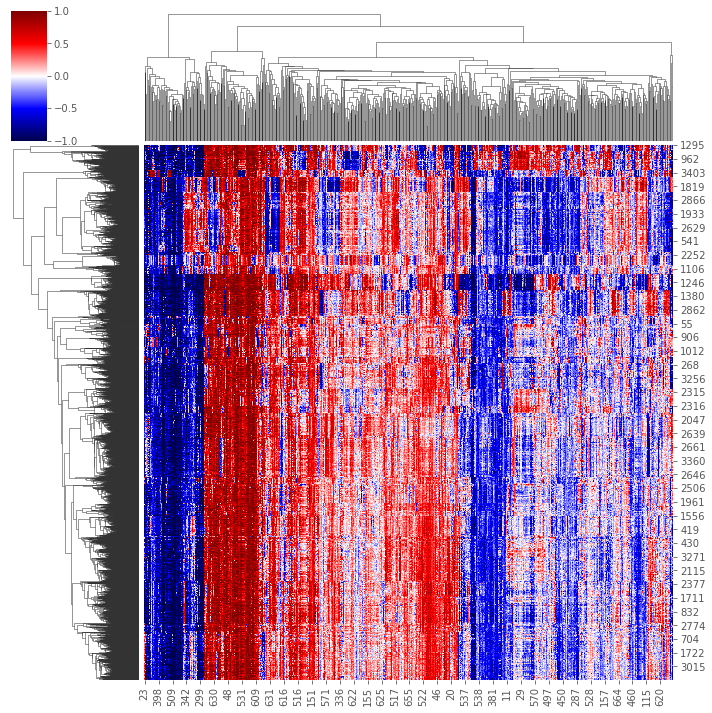

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


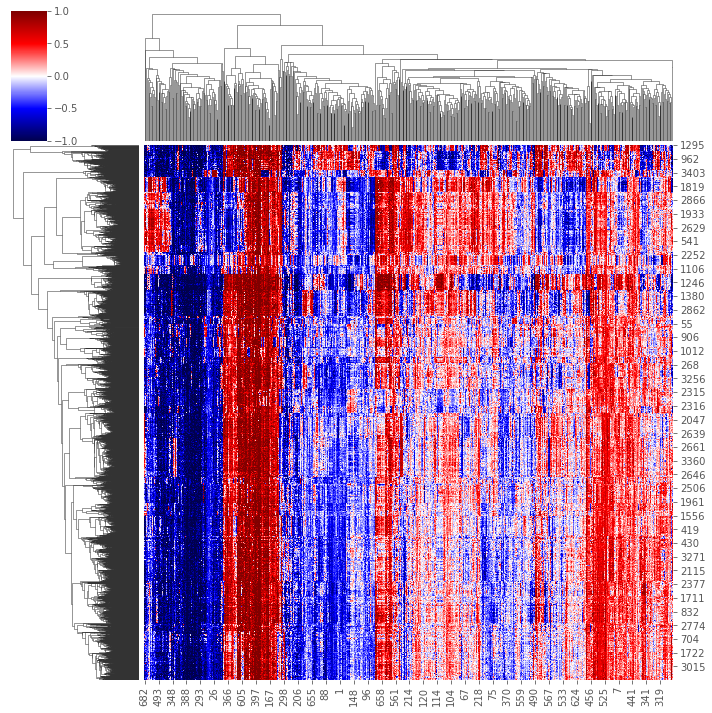

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


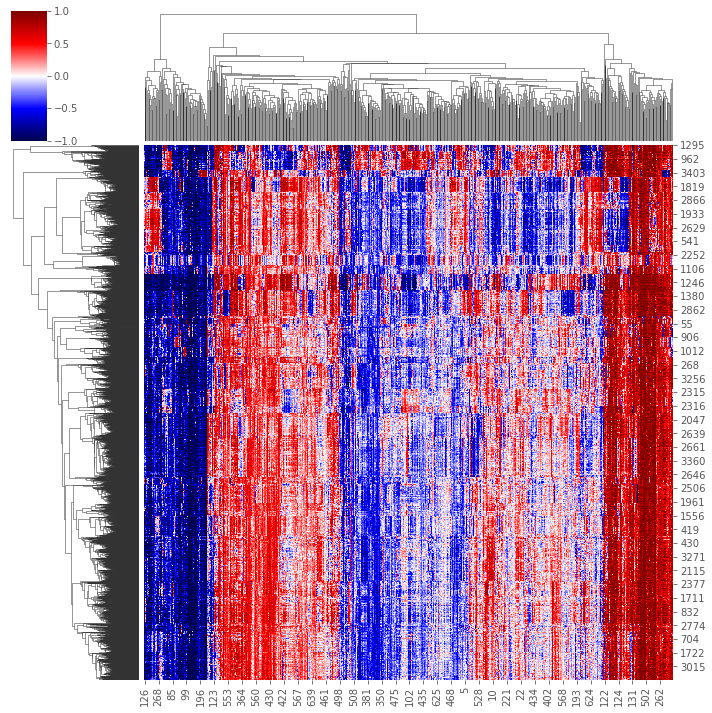

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


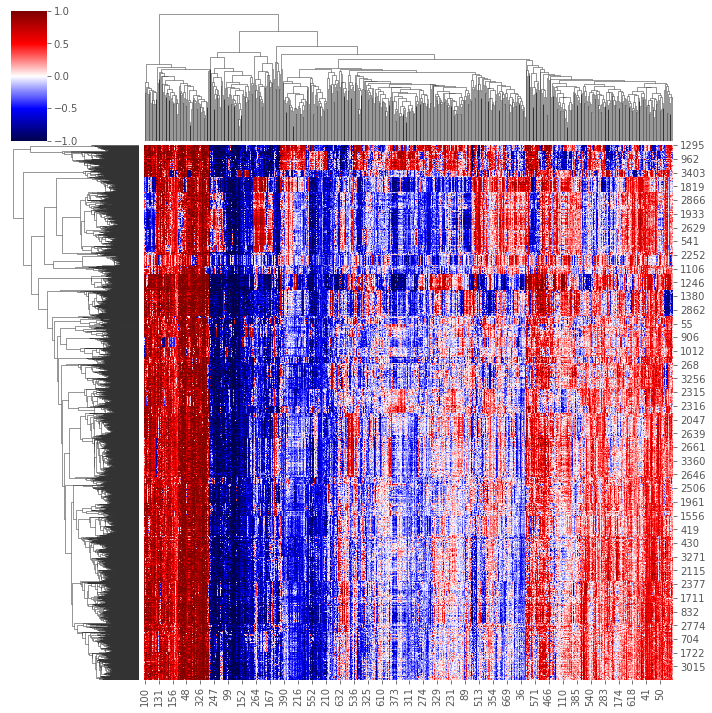

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


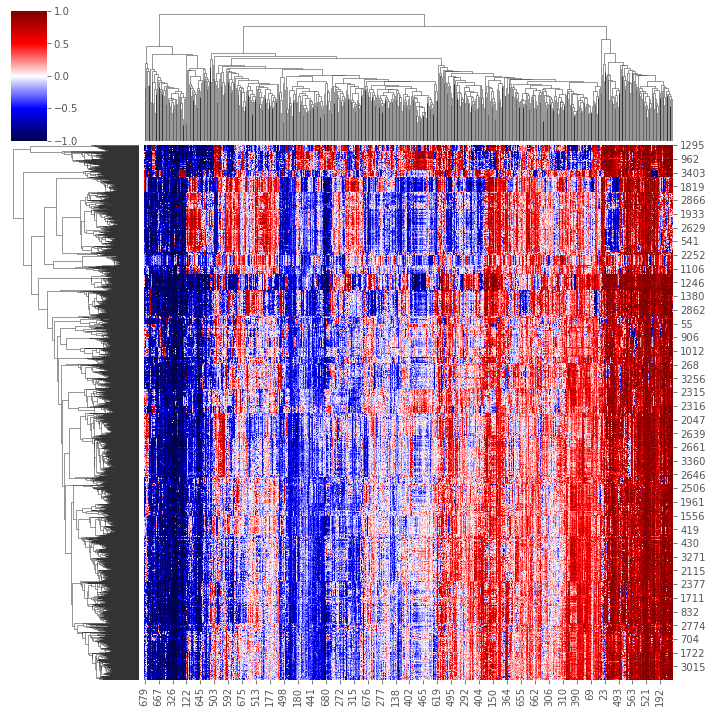

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


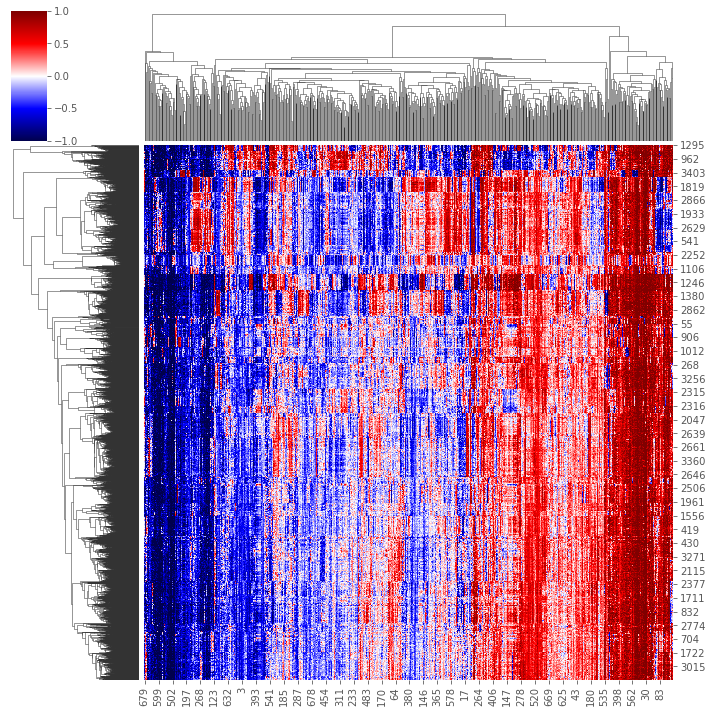

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


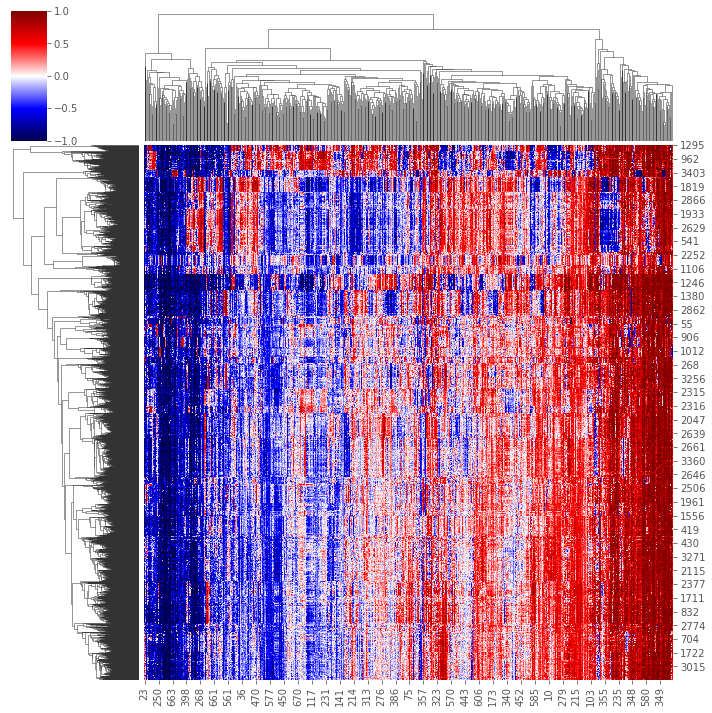

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


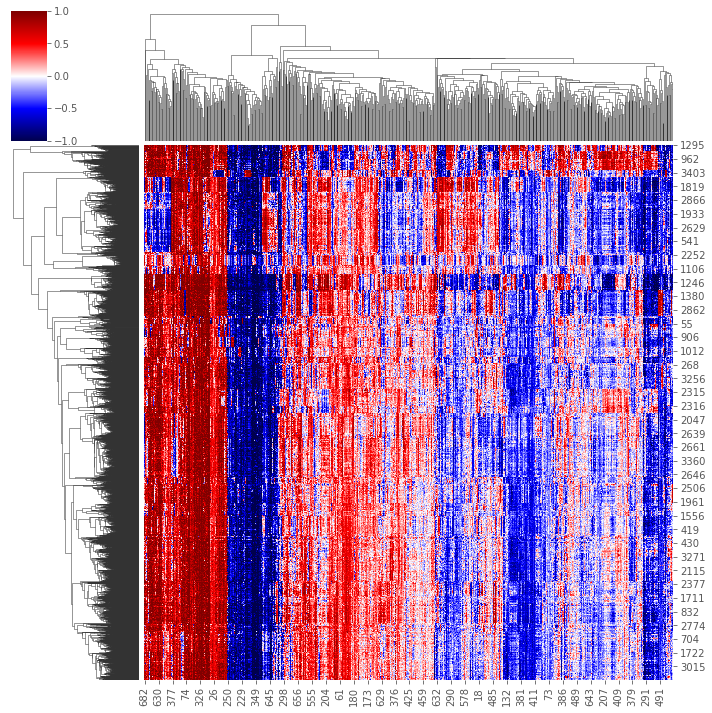

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


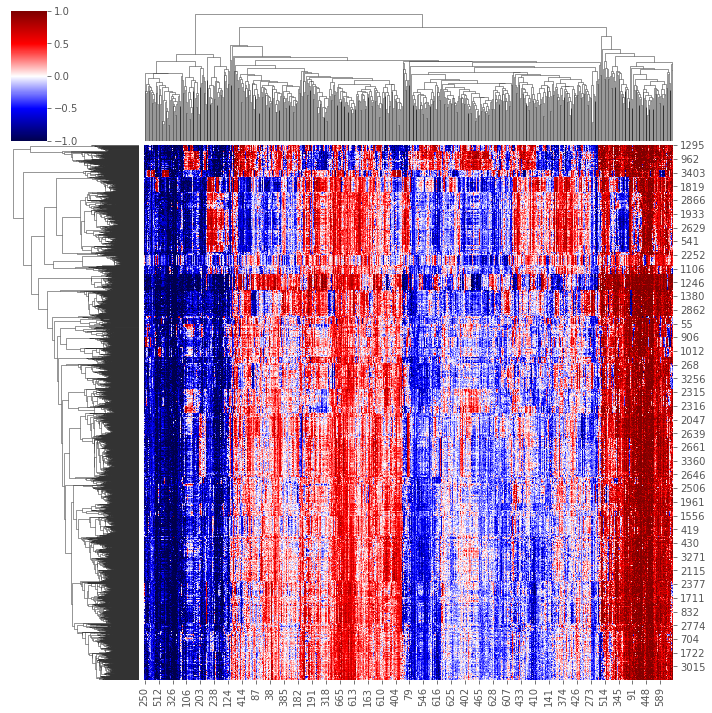

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


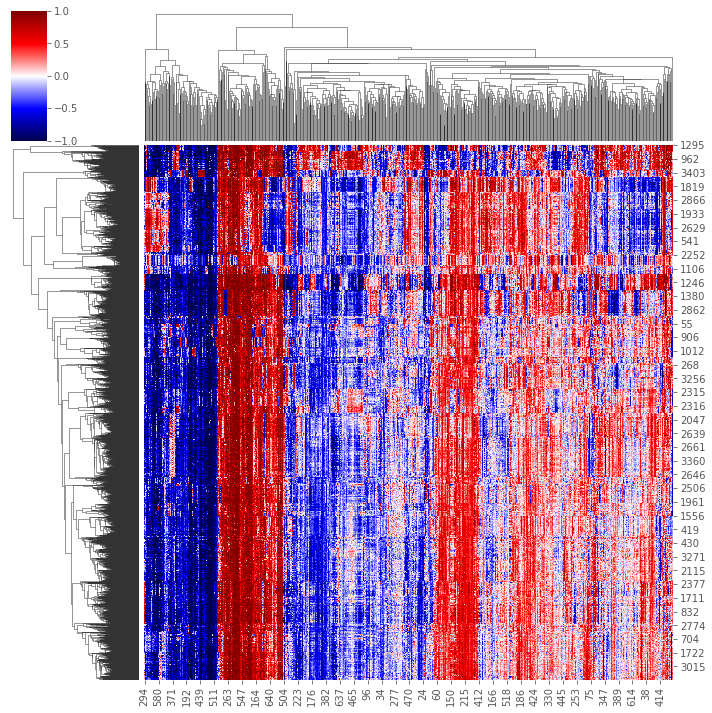

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


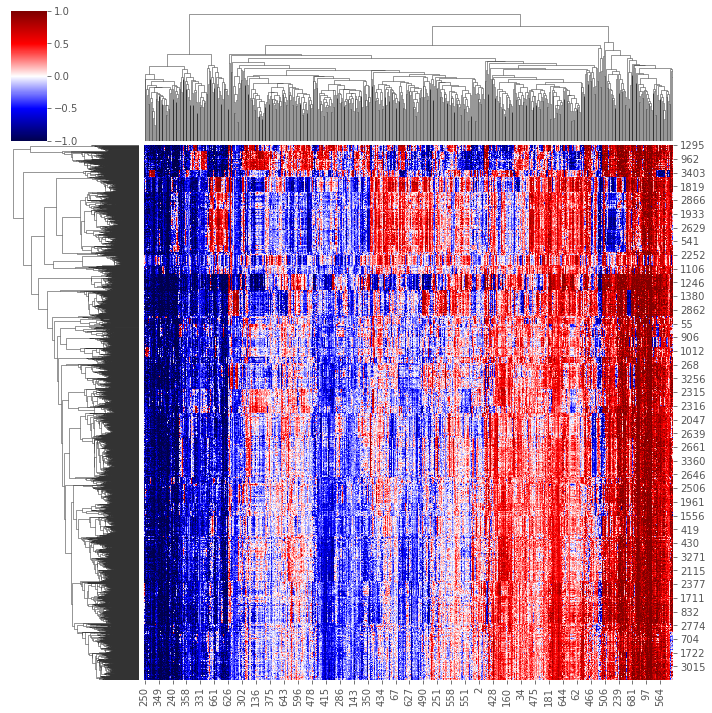

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


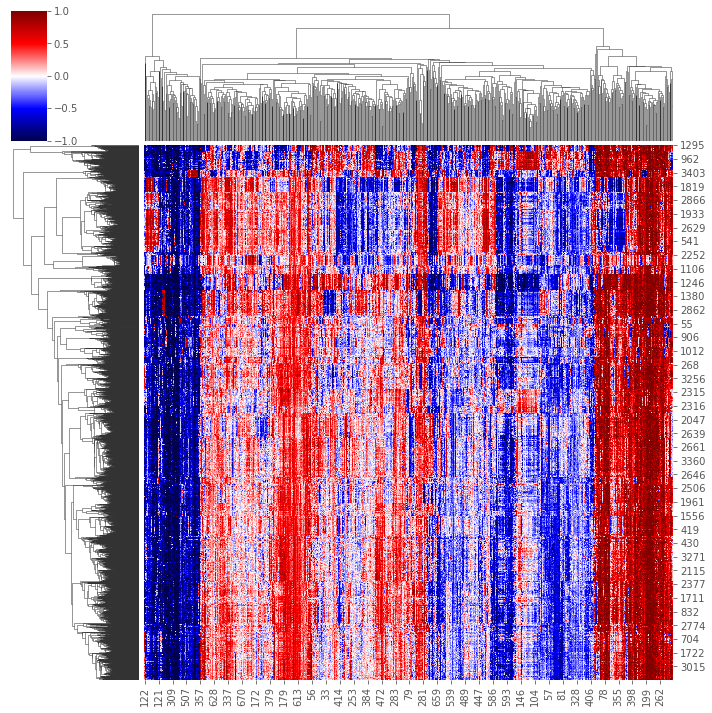

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


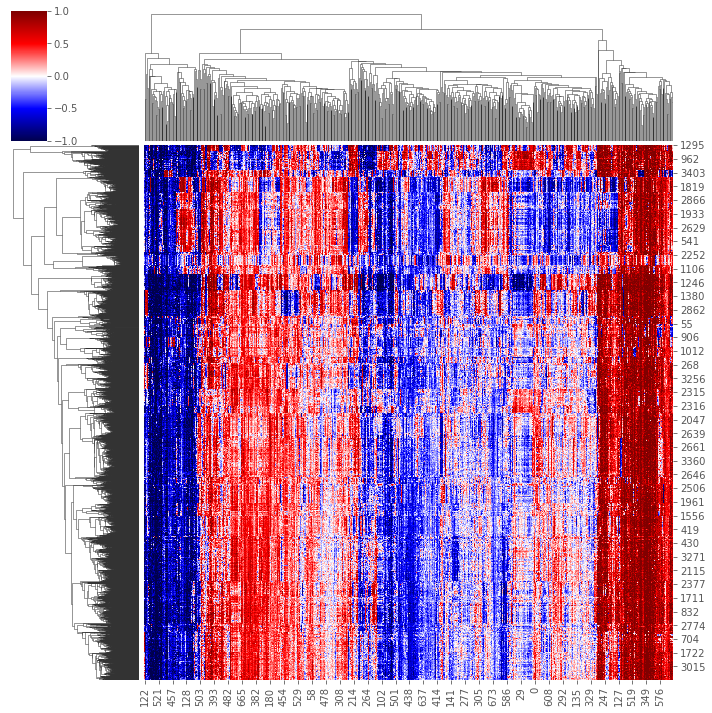

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


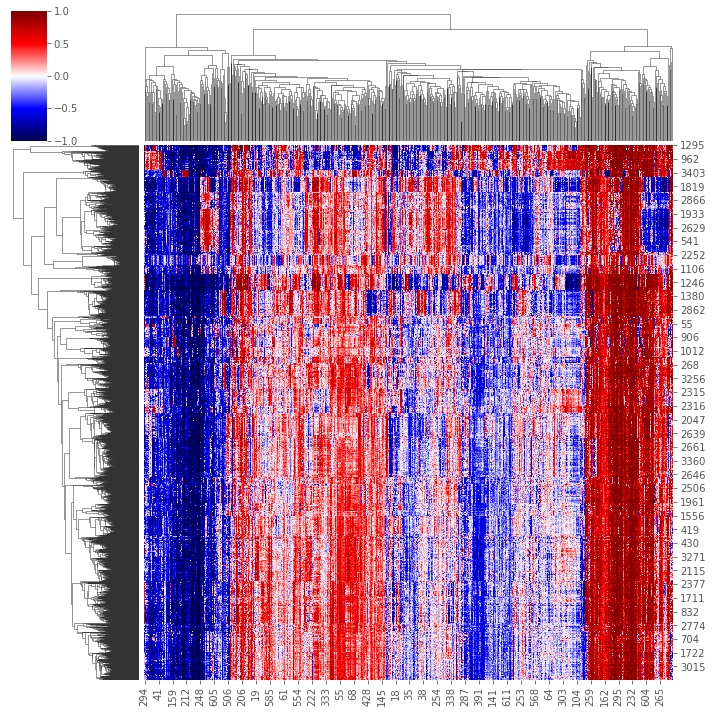

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


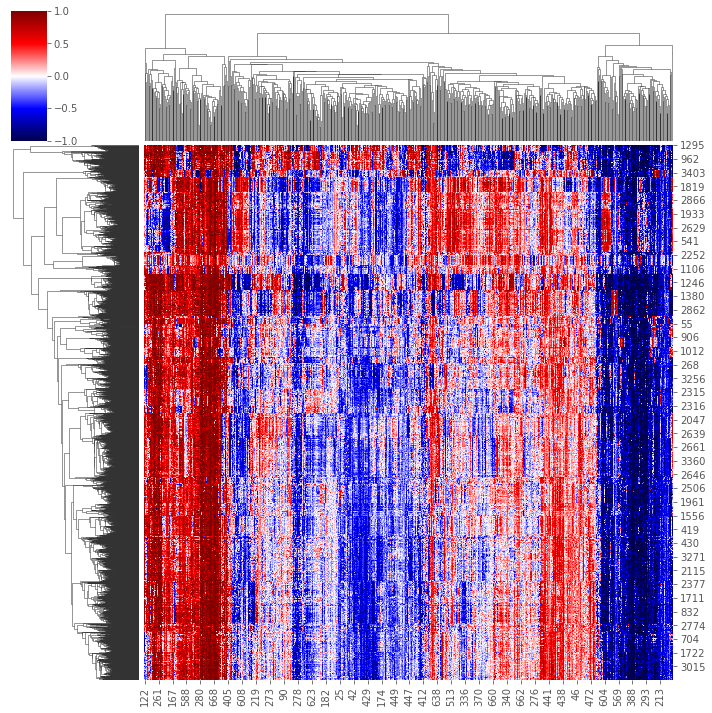

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


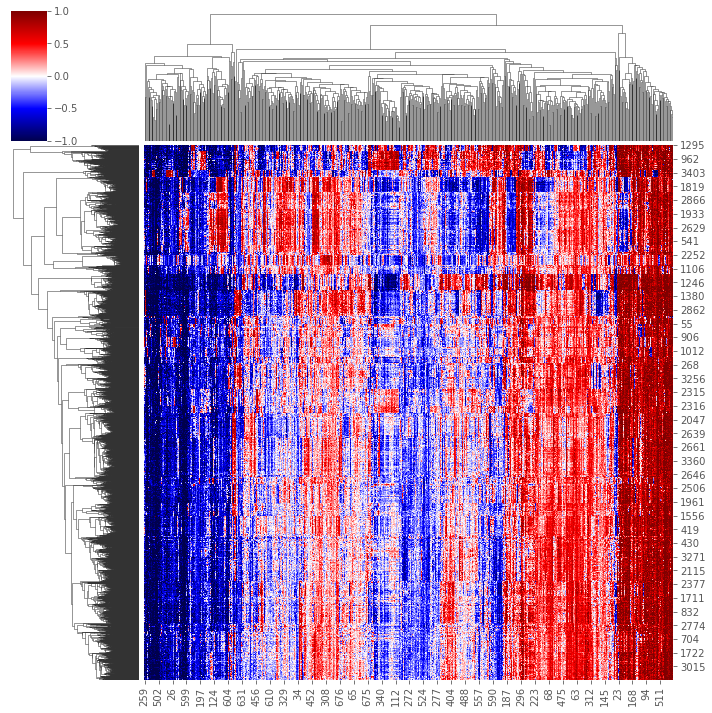

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


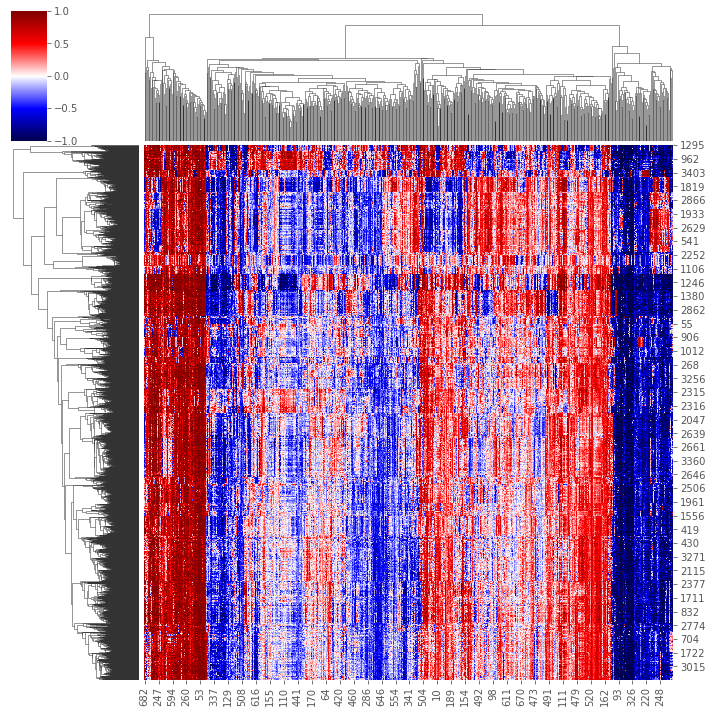

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


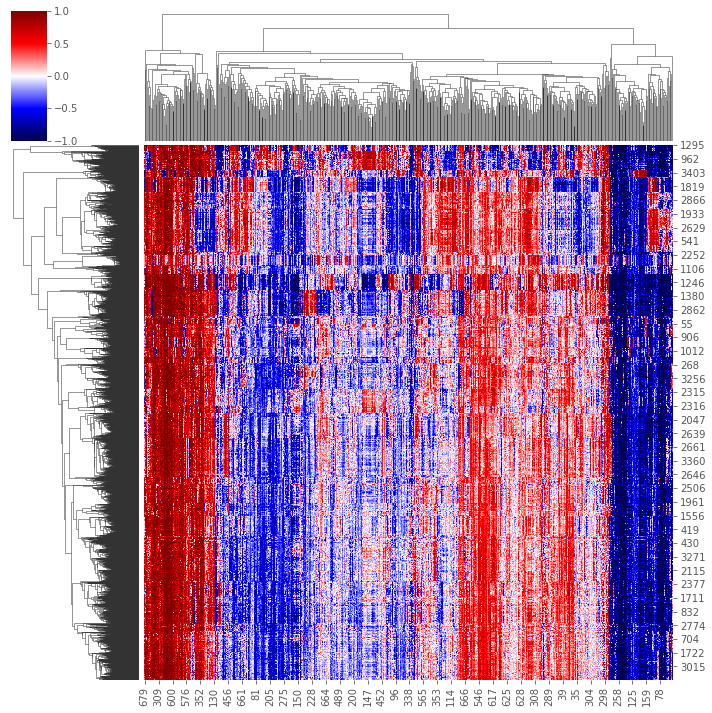

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


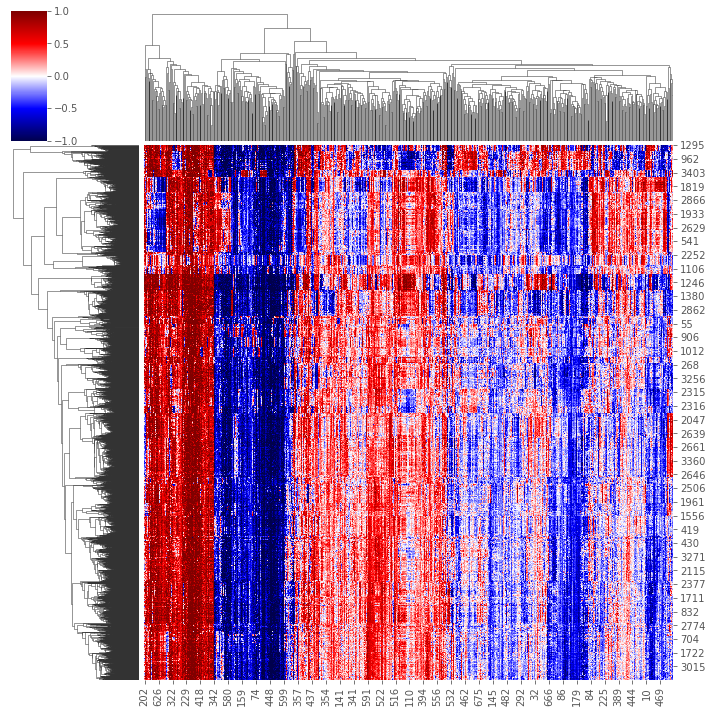

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


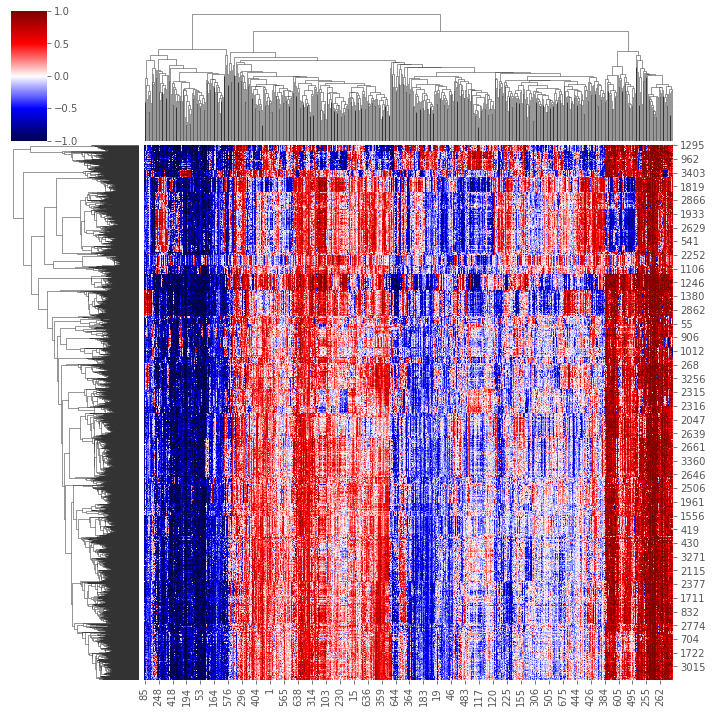

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


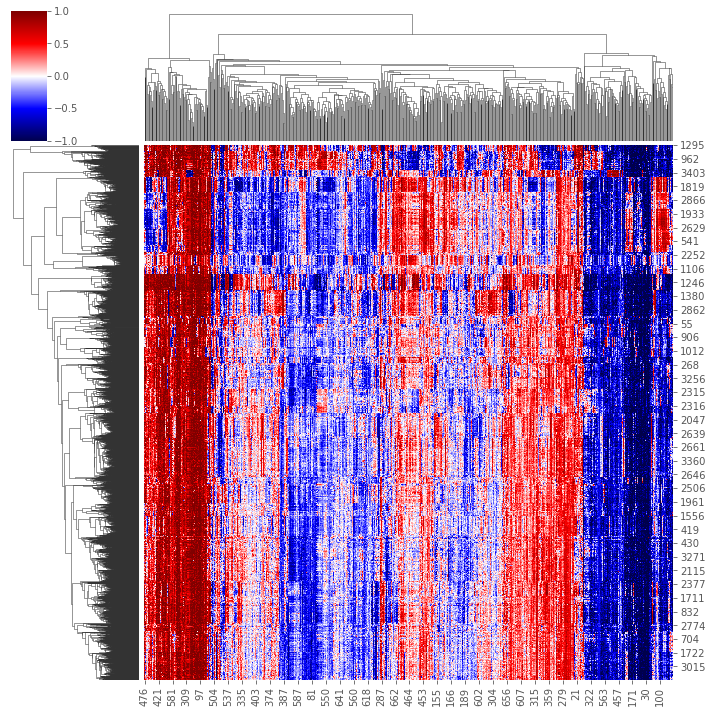

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


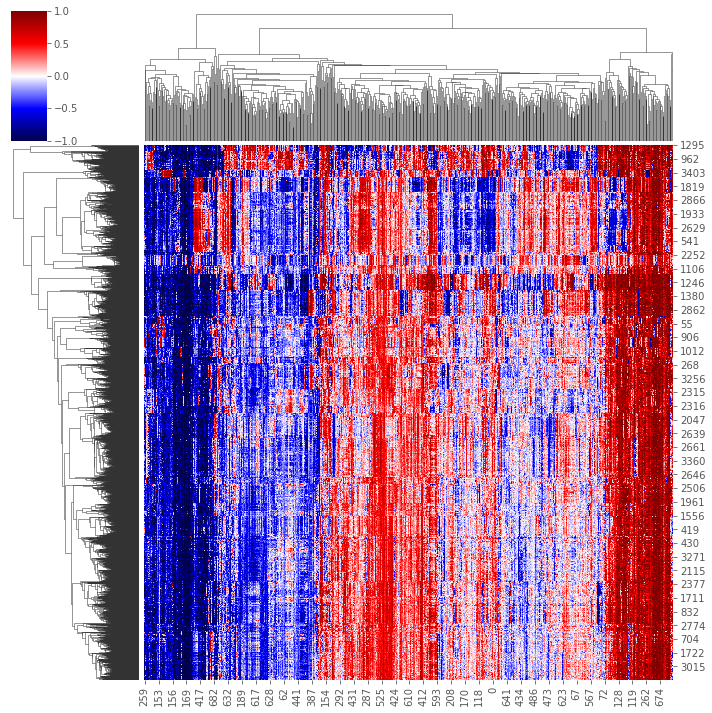

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


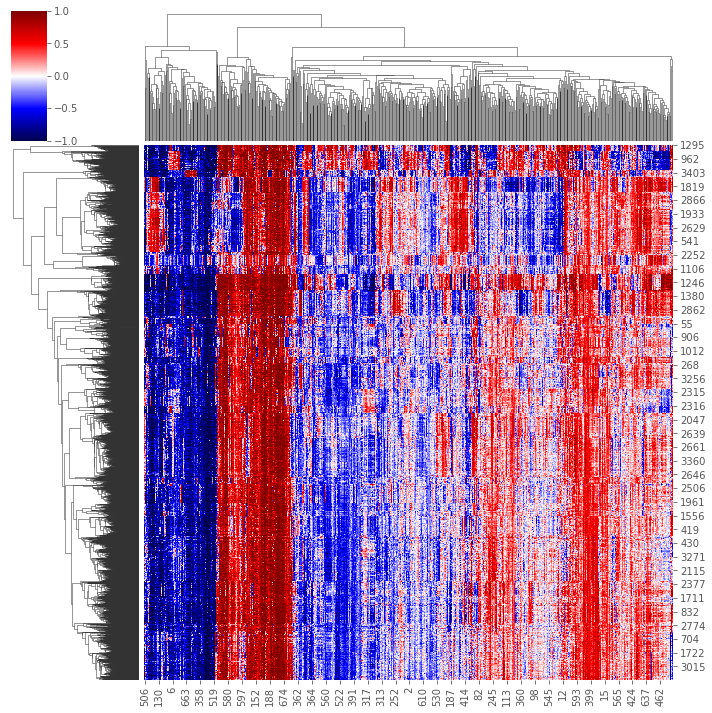

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


KeyboardInterrupt: 

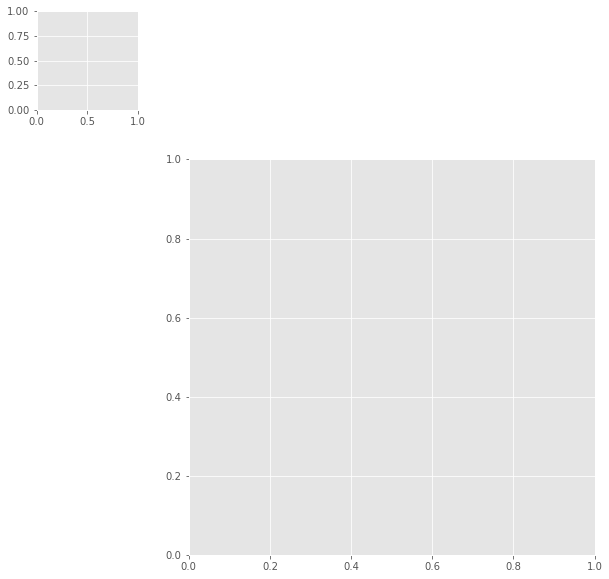

In [96]:
for i in range(s.shape[1]):
    x = s[:,i,:]
    x = MinMaxScaler(feature_range=(-1, 1)).fit_transform(x)
    sns.clustermap(x, cmap="seismic")
    plt.show()

In [ ]:
from cuml.experimental.explainer import KernelExplainer

In [ ]:
cu_explainer = KernelExplainer(
    model=model.predict,
    data=X_train.sample(frac=0.3),
    gpu_model=False
)

In [ ]:
shap_values = cu_explainer.shap_values(X_test.sample(frac=0.3))

In [15]:
import torch
import gpytorch

In [18]:
train_x = torch.from_numpy(X_train.values).float().contiguous().cuda()
train_y = torch.from_numpy(y_train.values).float().contiguous().cuda()
test_x = torch.from_numpy(X_test.values).float().contiguous().cuda()
test_y = torch.from_numpy(y_test.values).float().contiguous().cuda()

In [19]:
train_x.shape, train_y.shape

(torch.Size([8181, 683]), torch.Size([8181, 80]))

In [20]:
n_tasks = y_test.shape[1]
n_tasks // 2

40

In [21]:
rank = y_test.columns.str.split(".").str[1].nunique()
class MultitaskGPModel(gpytorch.models.ExactGP):
    def __init__(self, train_x, train_y, likelihood):
        super(MultitaskGPModel, self).__init__(train_x, train_y, likelihood)
        self.mean_module = gpytorch.means.MultitaskMean(
            gpytorch.means.ConstantMean(), num_tasks=n_tasks
        )
        self.covar_module = gpytorch.kernels.MultitaskKernel(
            gpytorch.kernels.LinearKernel(), num_tasks=n_tasks, rank=rank
        )

    def forward(self, x):
        mean_x = self.mean_module(x)
        covar_x = self.covar_module(x)
        return gpytorch.distributions.MultitaskMultivariateNormal(mean_x, covar_x)


likelihood = gpytorch.likelihoods.MultitaskGaussianLikelihood(num_tasks=n_tasks).cuda()
model = MultitaskGPModel(train_x, train_y, likelihood).cuda()

In [22]:
training_iterations = 60

# Find optimal model hyperparameters
model.train()
likelihood.train()

# Use the adam optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.1)  # Includes GaussianLikelihood parameters

# "Loss" for GPs - the marginal log likelihood
mll = gpytorch.mlls.ExactMarginalLogLikelihood(likelihood, model)

for i in range(training_iterations):
    optimizer.zero_grad()
    output = model(train_x)
    loss = -mll(output, train_y)
    loss.backward()
    print('Iter %d/%d - Loss: %.3f' % (i + 1, training_iterations, loss.item()))
    optimizer.step()

Iter 1/60 - Loss: 9945.007
Iter 2/60 - Loss: 9646.323
Iter 3/60 - Loss: 9343.272
Iter 4/60 - Loss: 9037.352
Iter 5/60 - Loss: 8728.599
Iter 6/60 - Loss: 8417.627
Iter 7/60 - Loss: 8106.708
Iter 8/60 - Loss: 7797.056
Iter 9/60 - Loss: 7488.105
Iter 10/60 - Loss: 7180.100
Iter 11/60 - Loss: 6873.920
Iter 12/60 - Loss: 6571.181
Iter 13/60 - Loss: 6273.098
Iter 14/60 - Loss: 5979.865
Iter 15/60 - Loss: 5692.407
Iter 16/60 - Loss: 5412.261
Iter 17/60 - Loss: 5140.038
Iter 18/60 - Loss: 4876.160
Iter 19/60 - Loss: 4623.617
Iter 20/60 - Loss: 4383.827
Iter 21/60 - Loss: 4155.570
Iter 22/60 - Loss: 3939.687
Iter 23/60 - Loss: 3739.221
Iter 24/60 - Loss: 3555.080
Iter 25/60 - Loss: 3385.024
Iter 26/60 - Loss: 3202.749
Iter 27/60 - Loss: 3019.818
Iter 28/60 - Loss: 2872.536
Iter 29/60 - Loss: 2751.912
Iter 30/60 - Loss: 2677.850
Iter 31/60 - Loss: 2605.939
Iter 32/60 - Loss: 2543.946
Iter 33/60 - Loss: 2507.837
Iter 34/60 - Loss: 2480.163
Iter 35/60 - Loss: 2467.222
Iter 36/60 - Loss: 2465.510
I

In [53]:
num_latents = num_pathways
num_tasks = n_tasks

class MultitaskGPModel(gpytorch.models.ApproximateGP):
    def __init__(self):
        # Let's use a different set of inducing points for each latent function
        inducing_points = torch.rand(num_latents, 16, train_x.shape[1])
        
        # We have to mark the CholeskyVariationalDistribution as batch
        # so that we learn a variational distribution for each task
        variational_distribution = gpytorch.variational.CholeskyVariationalDistribution(
            inducing_points.size(-2), batch_shape=torch.Size([num_latents])
        )
        
        # We have to wrap the VariationalStrategy in a LMCVariationalStrategy
        # so that the output will be a MultitaskMultivariateNormal rather than a batch output
        variational_strategy = gpytorch.variational.LMCVariationalStrategy(
            gpytorch.variational.VariationalStrategy(
                self, inducing_points, variational_distribution, learn_inducing_locations=True
            ),
            num_tasks=num_tasks,
            num_latents=num_latents,
            latent_dim=-1
        )
        
        super().__init__(variational_strategy)
        
        # The mean and covariance modules should be marked as batch
        # so we learn a different set of hyperparameters
        self.mean_module = gpytorch.means.ConstantMean(batch_shape=torch.Size([num_latents]))
        self.covar_module = gpytorch.kernels.ScaleKernel(
            gpytorch.kernels.RBFKernel(batch_shape=torch.Size([num_latents])),
            batch_shape=torch.Size([num_latents])
        )
        
    def forward(self, x):
        # The forward function should be written as if we were dealing with each output
        # dimension in batch
        mean_x = self.mean_module(x)
        covar_x = self.covar_module(x)
        return gpytorch.distributions.MultivariateNormal(mean_x, covar_x)


model = MultitaskGPModel().cuda()
likelihood = gpytorch.likelihoods.MultitaskGaussianLikelihood(num_tasks=num_tasks).cuda()

In [54]:
likelihood(model(train_x)).rsample().shape

torch.Size([8181, 80])

In [57]:
from torch.utils.data import TensorDataset, DataLoader
train_dataset = TensorDataset(train_x, train_y)
train_loader = DataLoader(train_dataset, batch_size=500, shuffle=True)

test_dataset = TensorDataset(test_x, test_y)
test_loader = DataLoader(test_dataset, batch_size=500, shuffle=False)

In [82]:
num_epochs = 1000
mll = gpytorch.mlls.VariationalELBO(likelihood, model, num_data=train_y.numel())
optimizer = torch.optim.Adam(list(model.parameters()) + list(likelihood.parameters()), lr=0.1)



In [83]:
num_epochs=10**4
# Training
model.train()
likelihood.train()
epochs_iter = tqdm.notebook.tqdm(range(num_epochs), desc=f"Training Mtask ")
for i in epochs_iter:
    # Within each iteration, we will go over each minibatch of data
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        output = model(x_batch)
        loss = -mll(output, y_batch)
        epochs_iter.set_postfix(loss=loss.item())
        loss.backward()
        optimizer.step()

# Testing
model.eval()
likelihood.eval()
#means = torch.tensor([0.])
means = []
with torch.no_grad():
    for x_batch, y_batch in test_loader:
        preds = model(x_batch)
        means.append(preds.mean.cpu())
        
print(r2_score(test_y.cpu().numpy(), np.vstack(means))
#means = means[1:]
#error = torch.mean(torch.abs(means - test_y.cpu()))
#print(f"Test {model_cls.__name__} MAE: {error.item()}")

-8604695575721158.0

In [79]:
from sklearn.metrics import r2_score

In [80]:
r2_score(test_y.cpu().numpy(), np.vstack(means))

-2.32418239296974

In [56]:
import tqdm

num_epochs = 10

model.train()
likelihood.train()

# We use SGD here, rather than Adam. Emperically, we find that SGD is better for variational regression
optimizer = torch.optim.Adam([
    {'params': model.parameters()},
    {'params': likelihood.parameters()},
], lr=0.1)

# Our loss object. We're using the VariationalELBO, which essentially just computes the ELBO
mll = gpytorch.mlls.VariationalELBO(likelihood, model, num_data=train_y.size(0))

# We use more CG iterations here because the preconditioner introduced in the NeurIPS paper seems to be less
# effective for VI.
epochs_iter = tqdm.tqdm_notebook(range(num_epochs), desc="Epoch")
for i in epochs_iter:
    # Within each iteration, we will go over each minibatch of data
    optimizer.zero_grad()
    output = model(train_x)
    loss = -mll(output, train_y)
    epochs_iter.set_postfix(loss=loss.item())
    loss.backward()
    optimizer.step()

<ipython-input-56-352a7830c8b1>:19: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  epochs_iter = tqdm.tqdm_notebook(range(num_epochs), desc="Epoch")


RuntimeError: CUDA out of memory. Tried to allocate 4.99 GiB (GPU 1; 31.75 GiB total capacity; 27.98 GiB already allocated; 1.89 GiB free; 28.36 GiB reserved in total by PyTorch)

In [23]:
# Set into eval mode
model.eval()
likelihood.eval()

# Make predictions
with torch.no_grad(), gpytorch.settings.fast_pred_var():
    predictions = likelihood(model(test_x))
    mean = predictions.mean

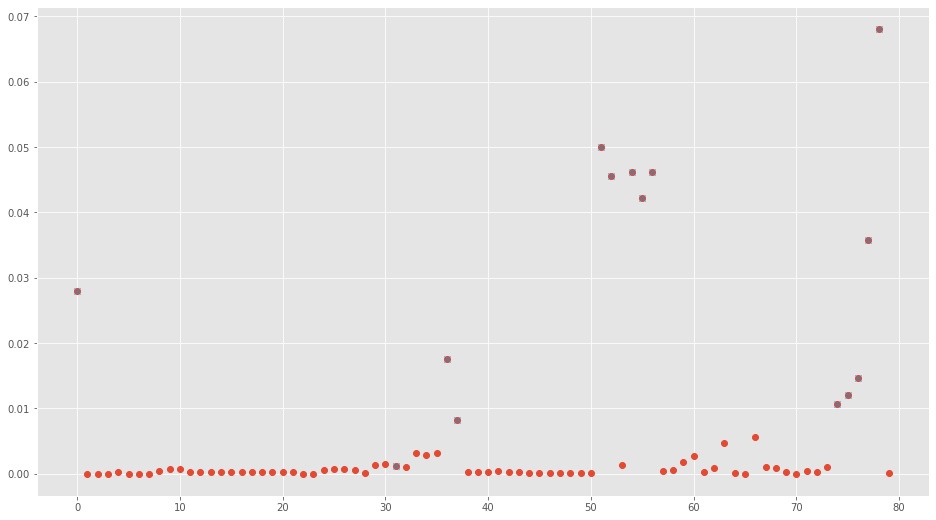

In [156]:
x = np.arange(Y.shape[1])
y = y_test.std().values.ravel()
y2 = r2_score(y_test, mean.cpu().numpy(), multioutput='raw_values')
query = y2>0

plt.figure(figsize=(16, 9))
plt.plot(x, y, "o")
plt.plot(x[query], y[query], "x")

In [24]:
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt

plt.style.use("ggplot")

In [25]:
preds = mean.cpu().numpy()

Text(0.5, 1.0, '0.88274195408701')

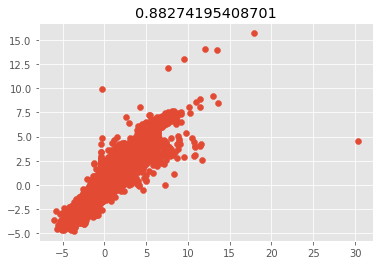

In [26]:
plt.scatter(y_test, mean.cpu())
plt.title(r2_score(y_test, mean.cpu().numpy(), multioutput='variance_weighted'))

In [27]:
x = r2_score(y_test, mean.cpu().numpy(), multioutput="raw_values")

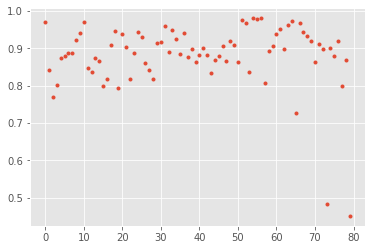

In [28]:
plt.plot(x, ".")

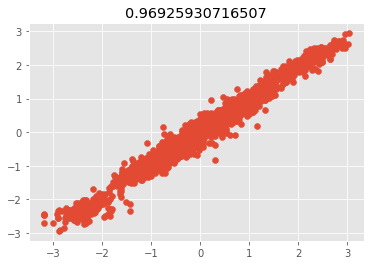

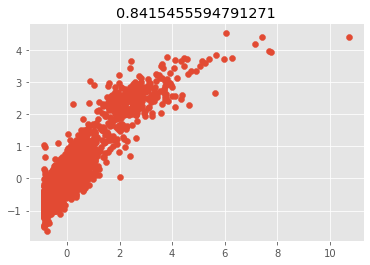

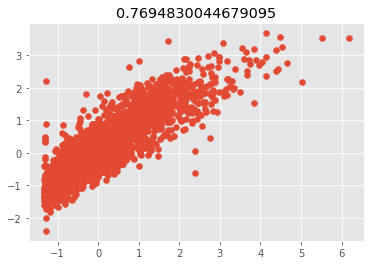

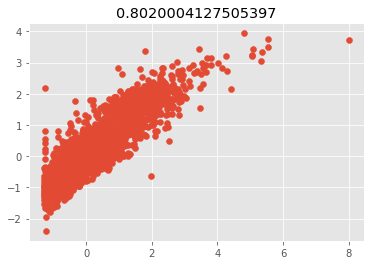

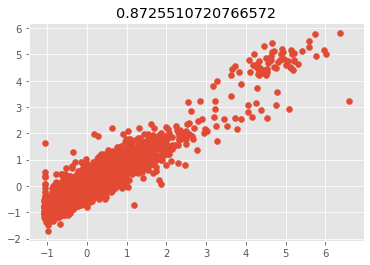

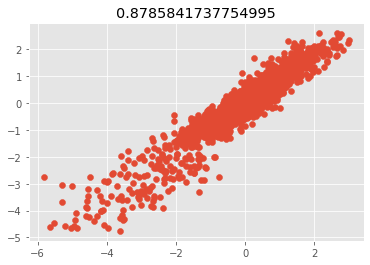

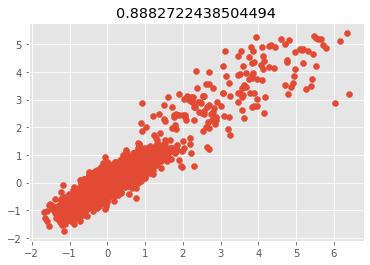

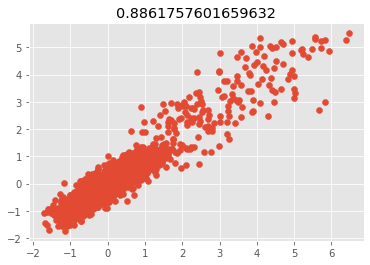

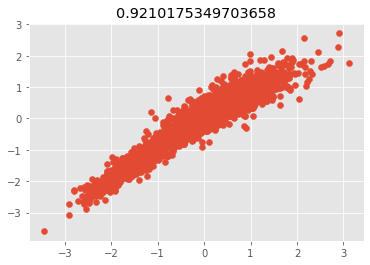

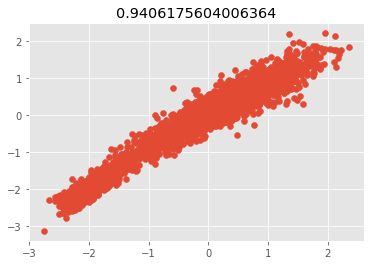

In [29]:
for i in range(10):
    plt.scatter(y_test.iloc[:, i], mean.cpu().numpy()[:, i])
    plt.title(r2_score(y_test.iloc[:, i], mean.cpu().numpy()[:, i]))
    plt.show()

In [ ]:
mean.cpu().numpy()

In [161]:
from catboost import CatBoostClassifier, CatBoostRegressor

train_data = [[0, 3],
              [4, 1],
              [8, 1],
              [9, 1]]
train_labels = [0, 0, 1, 1]

model = CatBoostRegressor(iterations=1000, 
                           task_type="CPU",
                           loss_function="MultiRMSE")
model.fit(X_train,
          y_train,
          verbose=False)

In [162]:
preds = model.predict(X_test)

In [163]:
r2_score(y_test, preds)

0.844267150962027

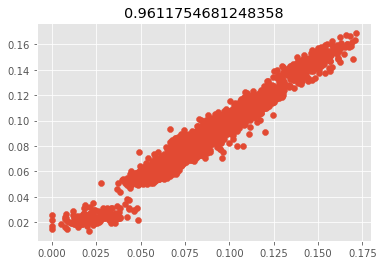

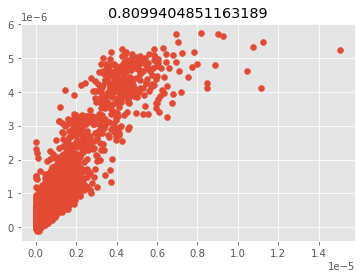

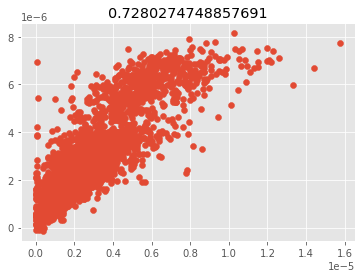

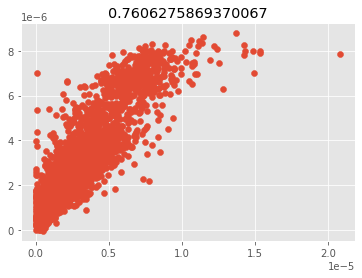

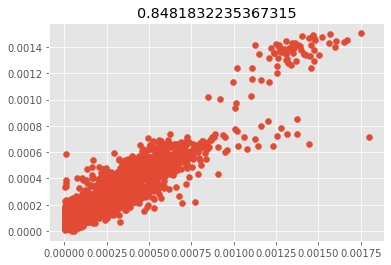

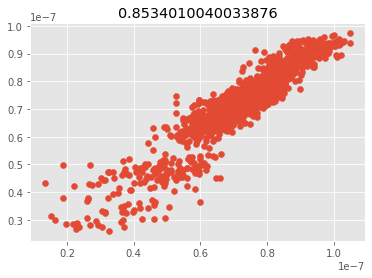

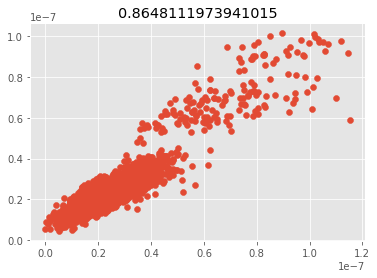

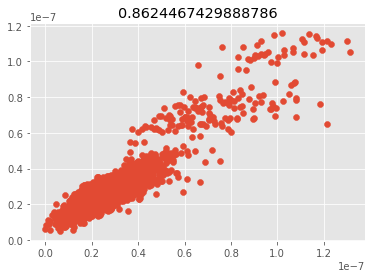

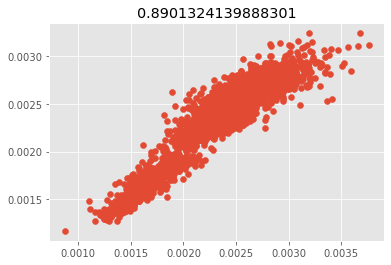

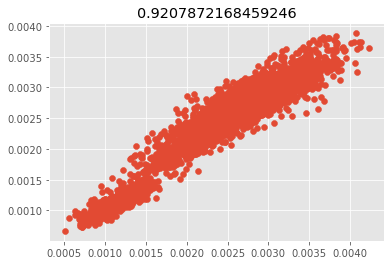

In [164]:
for i in range(10):
    plt.scatter(y_test.iloc[:, i], preds[:, i])
    plt.title(r2_score(y_test.iloc[:, i], preds[:, i]))
    plt.show()

In [171]:
import pandas as pd

In [167]:
i = model.get_feature_importance(data=None,
                       type="Interaction",
                       prettified=False,
                       thread_count=-1,
                       verbose=False)

In [173]:
df = pd.DataFrame(i)

In [176]:
df.iloc[: , 0] = df.iloc[: , 0].astype(int)
df.iloc[: , 1] = df.iloc[: , 1].astype(int)

In [177]:
df

,0,1,2
0,7,151,5.147942e-01
1,7,352,3.313964e-01
2,308,423,2.780623e-01
3,586,587,2.614908e-01
4,233,596,2.494077e-01
...,...,...,...
12286,27,642,1.847360e-06
12287,323,417,1.385647e-06
12288,89,248,9.094519e-07
12289,153,508,3.447085e-07


In [183]:
import catboost

In [184]:
s = model.get_feature_importance(data=catboost.Pool(X_test, y_test),
                       type="ShapValues",
                       prettified=False,
                       thread_count=-1,
                       verbose=False)

In [179]:
import shap

In [180]:
shap.TreeExplainer

AttributeError: module 'shap' has no attribute 'GPUTreeExplainer'

In [209]:
s.shape, X_test.shape, y_test.shape

((3507, 80, 684), (3507, 683), (3507, 80))

In [188]:
s[:, :, :-1].shape

(3507, 80, 683)

In [189]:
import sys


In [200]:
sys.path.append(project_folder.as_posix)

In [201]:
project_folder

PosixPath('/home/cloucera/projects/pyholird')

In [45]:
def compute_shap_values(estimator, X, y=None, approximate=True, check_additivity=False):
    explainer = shap.TreeExplainer(estimator)
    shap_values = explainer.shap_values(
        X, approximate=approximate, check_additivity=check_additivity
    )

    return shap_values

def compute_shap_fs(relevances, q=0.95, by_circuit=False):

    by_circuit_frame = relevances.abs().apply(lambda x: x > np.quantile(x, q), axis=1)

    if by_circuit:
        res = by_circuit_frame
    else:
        res = by_circuit_frame.any().values

    return res


def compute_shap_relevance(shap_values, X, Y):

    feature_names = X.columns
    task_names = Y.columns

    n_features = len(feature_names)
    n_tasks = len(task_names)

    corr_sign = lambda x, y: np.sign(pearsonr(x, y)[0])
    signs = Parallel(n_jobs=-1)(
        delayed(corr_sign)(X.iloc[:, x_col], shap_values[:, y_col, x_col])
        for x_col in range(n_features)
        for y_col in range(n_tasks)
    )

    signs = np.array(signs).reshape((n_tasks, n_features), order="F")
    signs = pd.DataFrame(signs, index=Y.columns, columns=X.columns)

    #shap_values = np.array(shap_values)

    shap_relevance = pd.DataFrame(
        np.abs(shap_values).mean(axis=(0)), index=task_names, columns=feature_names
    )

    shap_relevance = shap_relevance * signs
    shap_relevance = shap_relevance.fillna(0.0)

    return shap_relevance

In [52]:
from joblib import Parallel, delayed
from scipy.stats import pearsonr
import joblib
import stability as stab

In [218]:
rel = compute_shap_relevance(s[:, :, :-1], X_test, y_test)

In [224]:
compute_shap_fs(rel, by_circuit=True).any(axis=0).sum()

245

In [229]:
type(CatBoostRegressor())

catboost.core.CatBoostRegressor

In [260]:

def run_stability(model, X, Y, alpha=0.05, approximate=True, check_additivity=False):
    n_bootstraps = 100
    n_samples, n_variables = X.shape
    sample_fraction = 0.5
    n_subsamples = np.floor(sample_fraction * n_samples).astype(int)

    q = 0.95

    # lambda: quantile selected

    Z = np.zeros((n_bootstraps, n_variables), dtype=np.int8)
    errors = np.zeros(n_bootstraps)

    stability_cv = ShuffleSplit(
        n_splits=n_bootstraps, train_size=n_subsamples, random_state=0
    )

    def stab_i(model, X, Y, n_split, split, q=0.95):
        train, test = split
        X_train = X.iloc[train, :]
        Y_train = Y.iloc[train, :]
        X_test = X.iloc[test, :]
        Y_test = Y.iloc[test, :]

        X_learn, X_val, Y_learn, Y_val = train_test_split(
            X_train, Y_train, test_size=0.3, random_state=n_split
        )

        model_ = CatBoostRegressor(iterations=500, 
                           task_type="CPU",
                                   eval_metric="MultiRMSE",
                           loss_function="MultiRMSE")
        model_.fit(X_learn, Y_learn, eval_set=(X_val, Y_val), early_stopping_rounds=10, verbose=10)
        print("fit")
        # FS using shap relevances
        shap_values = model_.get_feature_importance(data=catboost.Pool(X_val, Y_val),
                       type="ShapValues",
                       prettified=False,
                       thread_count=-1,
                       verbose=False)
        shap_values = shap_values[:,:,:-1]
        shap_relevances = compute_shap_relevance(shap_values, X_val, Y_val)
        filt_i = compute_shap_fs(shap_relevances, q=q, by_circuit=False)

        X_train_filt = X_train.loc[:, filt_i]
        X_test_filt = X_test.loc[:, filt_i]

        sub_model = CatBoostRegressor(iterations=500, 
                           task_type="CPU",
                           loss_function="MultiRMSE")
        # sub_model.set_params(max_features=1.0)
        sub_model.fit(X_train_filt, Y_train, eval_set=(X_test_filt, Y_test), early_stopping_rounds=10, verbose=9)
        Y_test_filt_preds = sub_model.predict(X_test_filt)

        r2_loss = 1.0 - r2_score(Y_test, Y_test_filt_preds)
        mo_r2_loss = 1.0 - r2_score(
            Y_test, Y_test_filt_preds, multioutput="raw_values"
        )
        
        print(sum(filt_i), r2_score(Y_test, model_.predict(X_test)), r2_loss)

        return (filt_i, r2_loss, mo_r2_loss)

    stab_values = Parallel(n_jobs=1)(
        delayed(stab_i)(None, X, Y, n_split, split)
        for n_split, split in enumerate(stability_cv.split(X, Y))
    )

    for n_split, values in enumerate(stab_values):
        Z[n_split, :] = values[0]
        errors[n_split] = values[1]

    res = build_stability_dict(Z, errors, alpha)
    print(res)

    return res

In [ ]:
r = run_stability(None, X, Y)

0:	learn: 0.5181111	test: 0.5217347	best: 0.5217347 (0)	total: 1.27s	remaining: 10m 31s
10:	learn: 0.3898865	test: 0.3931542	best: 0.3931542 (10)	total: 13.7s	remaining: 10m 11s
20:	learn: 0.2954713	test: 0.2983836	best: 0.2983836 (20)	total: 26.1s	remaining: 9m 56s
30:	learn: 0.2256179	test: 0.2282354	best: 0.2282354 (30)	total: 38.4s	remaining: 9m 40s
40:	learn: 0.1741762	test: 0.1765381	best: 0.1765381 (40)	total: 51s	remaining: 9m 30s
50:	learn: 0.1361603	test: 0.1384389	best: 0.1384389 (50)	total: 1m 3s	remaining: 9m 15s
60:	learn: 0.1080540	test: 0.1103399	best: 0.1103399 (60)	total: 1m 15s	remaining: 9m
70:	learn: 0.0884188	test: 0.0907773	best: 0.0907773 (70)	total: 1m 26s	remaining: 8m 45s
80:	learn: 0.0739894	test: 0.0764644	best: 0.0764644 (80)	total: 1m 38s	remaining: 8m 32s
90:	learn: 0.0635338	test: 0.0660149	best: 0.0660149 (90)	total: 1m 51s	remaining: 8m 19s
100:	learn: 0.0563264	test: 0.0588321	best: 0.0588321 (100)	total: 2m 3s	remaining: 8m 6s
110:	learn: 0.0510257	